## Data Understanding & Preparation (30 pts) 
- Data Semantic: introduce the variables with their meaning and characteristics; 
- Distribution of the variables and statistics: explore (single, pairs of...) variables quantitatively (e.g.,statistics, distributions); 
- Assessing data quality: are present errors, outliers, missing values, semantic inconsistencies, etc? 
- Variable transformations: is it better to use for further modules transformed variables (e.g.,log-			transformated)? 
- Pairwise correlations and eventual elimination of variables: matrix correlation (analyse high correlated variables).

Some useful links for understanding of attributes:
- https://www.spotify-song-stats.com/about
- https://towardsdatascience.com/is-my-spotify-music-boring-an-analysis-involving-music-data-and-machine-learning-47550ae931de

In [2]:
import numpy as np 
import pandas as pd 

import matplotlib.pyplot as plt 
import seaborn as sns

# import dataset
df_original_copy = pd.read_csv("dataset (missing + split)/train.csv", skipinitialspace=True)
df = pd.read_csv("dataset (missing + split)/train.csv", skipinitialspace=True) #this will be modified

In [3]:
df

,name,duration_ms,explicit,popularity,artists,album_name,danceability,energy,key,loudness,...,liveness,valence,tempo,features_duration_ms,time_signature,n_beats,n_bars,popularity_confidence,processing,genre
0,Long Road,241760,False,46,Funki Porcini,Hed Phone Sex,0.690,0.513,5,-12.529,...,0.2810,0.6350,142.221,241760,4.0,567.0,141.0,NaN,1.279305,j-dance
1,"Daniâl My Son, Where Did You Vanish?",444000,False,0,Siavash Amini,A Trail of Laughters,0.069,0.196,1,-24.801,...,0.3600,0.0336,75.596,444000,4.0,617.0,155.0,NaN,2.367412,iranian
2,Ondskapens Galakse,333506,False,3,Kvelertak,Nattesferd,0.363,0.854,2,-7.445,...,0.2620,0.4890,116.628,333507,4.0,652.0,162.0,NaN,3.700483,black-metal
3,Can't Look Away,269800,False,23,The Wood Brothers,One Drop of Truth,0.523,0.585,5,-5.607,...,0.1170,0.3850,140.880,269800,4.0,619.0,155.0,0.469,1.279305,bluegrass
4,Thunderground,307651,False,25,The Darkraver;DJ Vince,Happy Hardcore Top 100,0.643,0.687,7,-11.340,...,0.2990,0.6370,143.956,307652,4.0,733.0,183.0,NaN,4.067086,happy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,Outpt,432026,False,0,Autechre,EP7,0.554,0.657,1,-14.232,...,0.1320,0.0335,117.319,432027,NaN,837.0,212.0,NaN,2.367412,idm
14996,Natural Environment Sounds: To Improve Sleep a...,182746,False,44,Natural White Noise Relaxation,Baby Sleep White Noise: Ultimate Album to Help...,0.103,0.860,1,-19.627,...,0.1230,0.0016,92.323,182747,3.0,277.0,92.0,NaN,2.367412,sleep
14997,Psychological Attack,400091,False,43,Droplex,Psychological Attack,0.799,0.535,1,-9.103,...,0.0713,0.0708,126.000,400091,4.0,837.0,209.0,NaN,2.367412,techno
14998,Don't Hate The 808 (feat. Lafa Taylor),197250,False,37,Bassnectar;Lafa Taylor,Noise vs Beauty,0.511,0.970,5,-2.299,...,0.4020,0.2700,160.044,197250,4.0,513.0,130.0,NaN,1.279305,breakbeat


In [9]:
df.dtypes


name                      object
duration_ms                int64
explicit                    bool
popularity                 int64
artists                   object
album_name                object
danceability             float64
energy                   float64
key                        int64
loudness                 float64
mode                     float64
speechiness              float64
acousticness             float64
instrumentalness         float64
liveness                 float64
valence                  float64
tempo                    float64
features_duration_ms       int64
time_signature           float64
n_beats                  float64
n_bars                   float64
popularity_confidence    float64
processing               float64
genre                     object
dtype: object

In [4]:
df['genre'].value_counts()

genre
j-dance          750
iranian          750
brazil           750
chicago-house    750
forro            750
idm              750
indian           750
study            750
disney           750
afrobeat         750
mandopop         750
techno           750
sleep            750
spanish          750
j-idol           750
industrial       750
happy            750
bluegrass        750
black-metal      750
breakbeat        750
Name: count, dtype: int64

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15000 entries, 0 to 14999
Data columns (total 24 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   name                   15000 non-null  object 
 1   duration_ms            15000 non-null  int64  
 2   explicit               15000 non-null  bool   
 3   popularity             15000 non-null  int64  
 4   artists                15000 non-null  object 
 5   album_name             15000 non-null  object 
 6   danceability           15000 non-null  float64
 7   energy                 15000 non-null  float64
 8   key                    15000 non-null  int64  
 9   loudness               15000 non-null  float64
 10  mode                   10550 non-null  float64
 11  speechiness            15000 non-null  float64
 12  acousticness           15000 non-null  float64
 13  instrumentalness       15000 non-null  float64
 14  liveness               15000 non-null  float64
 15  va

In [5]:
df['genre'].value_counts().sum()

15000

In [6]:
df.isnull().sum()

name                         0
duration_ms                  0
explicit                     0
popularity                   0
artists                      0
album_name                   0
danceability                 0
energy                       0
key                          0
loudness                     0
mode                      4450
speechiness                  0
acousticness                 0
instrumentalness             0
liveness                     0
valence                      0
tempo                        0
features_duration_ms         0
time_signature            2062
n_beats                      0
n_bars                       0
popularity_confidence    12783
processing                   0
genre                        0
dtype: int64

### Characteristics of some attributes
- **Speechiness**: “Speechiness detects the presence of spoken words in a track”. If the speechiness of a song is above 0.66, it is probably made of spoken words, a score between 0.33 and 0.66 is a song that may contain both music and words, and a score below 0.33 means the song does not have any speech;
- **Energy** “(energy) represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy”.
- **Liveness**: this value describes the probability that the song was recorded with a live audience. According to the official documentation “a value above 0.8 provides strong likelihood that the track is live”;
- **Valence**: “A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry)”.

### Data attributes distributions and correlations
In the following lines, the pdfs of the attributes and the correlation matrix will be analyzed. Task is data understanding for data preparation to clustering. 

In [5]:
pd.set_option("display.max_columns", 30) #In order to display all columns
display(df)

,name,duration_ms,explicit,popularity,artists,album_name,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,features_duration_ms,time_signature,n_beats,n_bars,popularity_confidence,processing,genre
0,Long Road,241760,False,46,Funki Porcini,Hed Phone Sex,0.690,0.513,5,-12.529,1.0,0.0975,0.302000,0.536000,0.2810,0.6350,142.221,241760,4.0,567.0,141.0,NaN,1.279305,j-dance
1,"Daniâl My Son, Where Did You Vanish?",444000,False,0,Siavash Amini,A Trail of Laughters,0.069,0.196,1,-24.801,0.0,0.0805,0.283000,0.934000,0.3600,0.0336,75.596,444000,4.0,617.0,155.0,NaN,2.367412,iranian
2,Ondskapens Galakse,333506,False,3,Kvelertak,Nattesferd,0.363,0.854,2,-7.445,NaN,0.0397,0.000089,0.800000,0.2620,0.4890,116.628,333507,4.0,652.0,162.0,NaN,3.700483,black-metal
3,Can't Look Away,269800,False,23,The Wood Brothers,One Drop of Truth,0.523,0.585,5,-5.607,1.0,0.0765,0.066400,0.001270,0.1170,0.3850,140.880,269800,4.0,619.0,155.0,0.469,1.279305,bluegrass
4,Thunderground,307651,False,25,The Darkraver;DJ Vince,Happy Hardcore Top 100,0.643,0.687,7,-11.340,1.0,0.0539,0.000576,0.096900,0.2990,0.6370,143.956,307652,4.0,733.0,183.0,NaN,4.067086,happy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,Outpt,432026,False,0,Autechre,EP7,0.554,0.657,1,-14.232,NaN,0.0558,0.016000,0.615000,0.1320,0.0335,117.319,432027,NaN,837.0,212.0,NaN,2.367412,idm
14996,Natural Environment Sounds: To Improve Sleep a...,182746,False,44,Natural White Noise Relaxation,Baby Sleep White Noise: Ultimate Album to Help...,0.103,0.860,1,-19.627,1.0,0.0595,0.548000,0.940000,0.1230,0.0016,92.323,182747,3.0,277.0,92.0,NaN,2.367412,sleep
14997,Psychological Attack,400091,False,43,Droplex,Psychological Attack,0.799,0.535,1,-9.103,NaN,0.0594,0.001830,0.857000,0.0713,0.0708,126.000,400091,4.0,837.0,209.0,NaN,2.367412,techno
14998,Don't Hate The 808 (feat. Lafa Taylor),197250,False,37,Bassnectar;Lafa Taylor,Noise vs Beauty,0.511,0.970,5,-2.299,1.0,0.0531,0.000337,0.000014,0.4020,0.2700,160.044,197250,4.0,513.0,130.0,NaN,1.279305,breakbeat


In [18]:
#Changing udm to duration_ms and features_duration_ms from ms to min
df['duration_ms'] *= 1/6e4
df['features_duration_ms'] *= 1/6e4
display(df)

,name,duration_ms,explicit,popularity,artists,album_name,danceability,energy,key,loudness,...,liveness,valence,tempo,features_duration_ms,time_signature,n_beats,n_bars,popularity_confidence,processing,genre
0,Long Road,4.029333,False,46,Funki Porcini,Hed Phone Sex,0.690,0.513,5,-12.529,...,0.2810,0.6350,142.221,4.029333,4.0,567.0,141.0,NaN,1.279305,j-dance
1,"Daniâl My Son, Where Did You Vanish?",7.400000,False,0,Siavash Amini,A Trail of Laughters,0.069,0.196,1,-24.801,...,0.3600,0.0336,75.596,7.400000,4.0,617.0,155.0,NaN,2.367412,iranian
2,Ondskapens Galakse,5.558433,False,3,Kvelertak,Nattesferd,0.363,0.854,2,-7.445,...,0.2620,0.4890,116.628,5.558450,4.0,652.0,162.0,NaN,3.700483,black-metal
3,Can't Look Away,4.496667,False,23,The Wood Brothers,One Drop of Truth,0.523,0.585,5,-5.607,...,0.1170,0.3850,140.880,4.496667,4.0,619.0,155.0,0.469,1.279305,bluegrass
4,Thunderground,5.127517,False,25,The Darkraver;DJ Vince,Happy Hardcore Top 100,0.643,0.687,7,-11.340,...,0.2990,0.6370,143.956,5.127533,4.0,733.0,183.0,NaN,4.067086,happy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14995,Outpt,7.200433,False,0,Autechre,EP7,0.554,0.657,1,-14.232,...,0.1320,0.0335,117.319,7.200450,NaN,837.0,212.0,NaN,2.367412,idm
14996,Natural Environment Sounds: To Improve Sleep a...,3.045767,False,44,Natural White Noise Relaxation,Baby Sleep White Noise: Ultimate Album to Help...,0.103,0.860,1,-19.627,...,0.1230,0.0016,92.323,3.045783,3.0,277.0,92.0,NaN,2.367412,sleep
14997,Psychological Attack,6.668183,False,43,Droplex,Psychological Attack,0.799,0.535,1,-9.103,...,0.0713,0.0708,126.000,6.668183,4.0,837.0,209.0,NaN,2.367412,techno
14998,Don't Hate The 808 (feat. Lafa Taylor),3.287500,False,37,Bassnectar;Lafa Taylor,Noise vs Beauty,0.511,0.970,5,-2.299,...,0.4020,0.2700,160.044,3.287500,4.0,513.0,130.0,NaN,1.279305,breakbeat


In [11]:
#Verifying if features_duration_ms is really redundant
array = np.array([df['duration_ms']-df['features_duration_ms']])
print(array)

[[ 0.00000000e+00  0.00000000e+00 -1.66666667e-05 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]]


In [12]:
print(f'The number of nonzero values of this array is:{np.count_nonzero(array)}')

The number of nonzero values of this array is:5832


In [13]:
arr_masked=array[array>(1e-5)]
print(arr_masked)
print(f'Counts of nonzero values greater than 1e-5: {len(arr_masked)}')

[1.56666667e-03 2.56120000e+00 2.36666667e-03 1.66166667e-02
 1.22066667e-01 2.79166667e-02 2.73333333e-03 7.33333333e-04
 7.83333333e-03 7.76533333e-01 7.00000000e-04 3.08500000e-02
 7.16666667e-04 1.76666667e-03 5.61666667e-03 1.08000000e-02
 5.51666667e-03 5.45000000e-03 1.36313333e+00 7.00000000e-03
 2.96666667e-03 3.66666667e-04 7.25000000e-03 1.14333333e-02
 3.27333333e-02 3.70000000e-03 2.52166667e-02 3.33333333e-04
 2.25000000e-02 5.13333333e-03 3.68333333e-03 1.41666667e-03
 9.33333333e-03 2.38333333e-03 4.61666667e-03 2.46833333e-02
 8.55000000e-03 1.03166667e-02 2.68333333e-03 6.58333333e-03]
Counts of nonzero values greater than 1e-5: 40


The attibute `features_duration_ms` is redundant, the maximum difference between this array and `duration_ms` is in the order of 1/10 of second. Because of this, one of this column will be deleted for data optimization.

In [14]:
del df['features_duration_ms']
df.dtypes

name                      object
duration_ms              float64
explicit                    bool
popularity                 int64
artists                   object
album_name                object
danceability             float64
energy                   float64
key                        int64
loudness                 float64
mode                     float64
speechiness              float64
acousticness             float64
instrumentalness         float64
liveness                 float64
valence                  float64
tempo                    float64
time_signature           float64
n_beats                  float64
n_bars                   float64
popularity_confidence    float64
processing               float64
genre                     object
dtype: object

### Analysis of attributes pdfs and correlations

In [33]:
#Counting NaN values in the datasets
df.isnull().sum()

name                         0
duration_ms                  0
explicit                     0
popularity                   0
artists                      0
album_name                   0
danceability                 0
energy                       0
key                          0
loudness                     0
mode                      4450
speechiness                  0
acousticness                 0
instrumentalness             0
liveness                     0
valence                      0
tempo                        0
time_signature            2062
n_beats                      0
n_bars                       0
popularity_confidence    12783
processing                   0
genre                        0
dtype: int64

In [8]:
df['mode'].value_counts()
#inpect what the mode is in music. Could this be a wrong reading of zero values? 

mode
1.0    6661
0.0    3889
Name: count, dtype: int64

An issue to be considered is the relationship between `popularity` and `popularity_confidence`. When the `popularity_confidence` is zero, the `popularity` attribute makes sense?

In [19]:
df.corr(numeric_only=True) #By default uses Pearson

,duration_ms,explicit,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,n_beats,n_bars,popularity_confidence,processing
duration_ms,1.000000,-0.048723,-0.076202,-0.080932,0.102996,0.016712,0.039403,-0.023310,-0.074774,-0.184902,0.079685,-0.021184,-0.141938,0.048765,0.009033,0.839313,0.838041,-0.005830,-0.010400
explicit,-0.048723,1.000000,-0.013096,0.056992,0.124405,-0.000991,0.131777,-0.042846,0.294287,-0.113975,-0.125101,0.006995,0.008631,0.016972,0.051260,-0.039830,-0.039435,0.029119,-0.005878
popularity,-0.076202,-0.013096,1.000000,0.051046,-0.056547,-0.008992,0.046703,0.073043,-0.096382,0.078424,-0.266843,0.027105,0.077652,-0.024162,-0.003160,-0.084774,-0.089134,-0.003665,0.008733
danceability,-0.080932,0.056992,0.051046,1.000000,0.193940,0.035311,0.385244,-0.072422,0.111454,-0.199082,-0.202316,-0.174193,0.559578,0.092267,0.292167,-0.033604,-0.069332,0.011602,-0.026273
energy,0.102996,0.124405,-0.056547,0.193940,1.000000,0.057815,0.720907,-0.079969,0.143454,-0.699454,-0.203111,0.191024,0.284069,0.331538,0.204646,0.243586,0.208615,0.040022,-0.037847
key,0.016712,-0.000991,-0.008992,0.035311,0.057815,1.000000,0.047718,-0.157515,0.018157,-0.049867,-0.001532,-0.007420,0.028221,0.022414,0.028388,0.027133,0.022042,0.019790,-0.490366
loudness,0.039403,0.131777,0.046703,0.385244,0.720907,0.047718,1.000000,-0.033544,0.109793,-0.552519,-0.447106,0.047502,0.377743,0.308203,0.250568,0.165565,0.131064,0.049174,-0.020563
mode,-0.023310,-0.042846,0.073043,-0.072422,-0.079969,-0.157515,-0.033544,1.000000,-0.064289,0.085246,-0.080035,0.015738,-0.006907,-0.013001,-0.019378,-0.030685,-0.027687,0.003698,0.261129
speechiness,-0.074774,0.294287,-0.096382,0.111454,0.143454,0.018157,0.109793,-0.064289,1.000000,-0.087997,-0.115803,0.050034,0.056068,0.062161,0.080739,-0.043217,-0.040820,0.026399,-0.022909
acousticness,-0.184902,-0.113975,0.078424,-0.199082,-0.699454,-0.049867,-0.552519,0.085246,-0.087997,1.000000,0.094256,-0.075924,-0.131961,-0.244244,-0.139706,-0.283324,-0.248164,-0.021155,0.022684


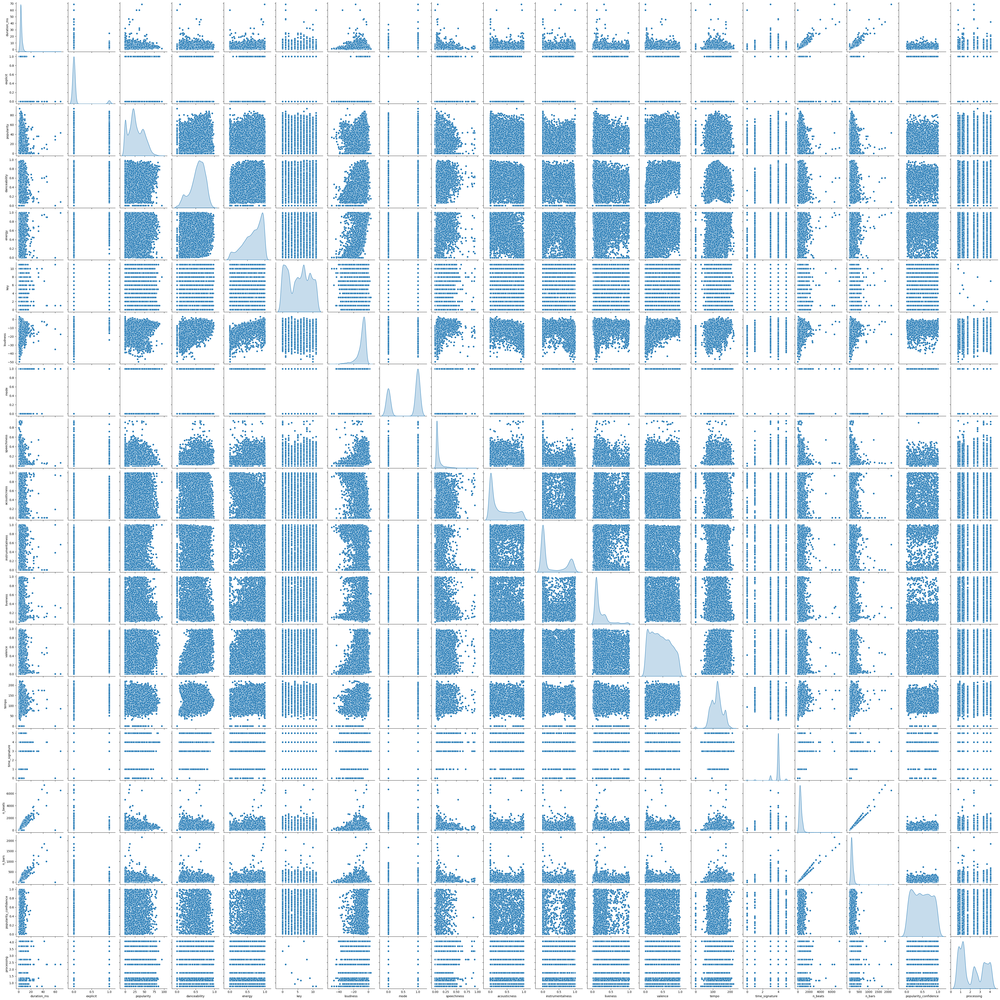

In [36]:
sns.pairplot(df,diag_kind='kde')
#kde is the distribution command for diagonal plot
plt.show()

<Axes: >

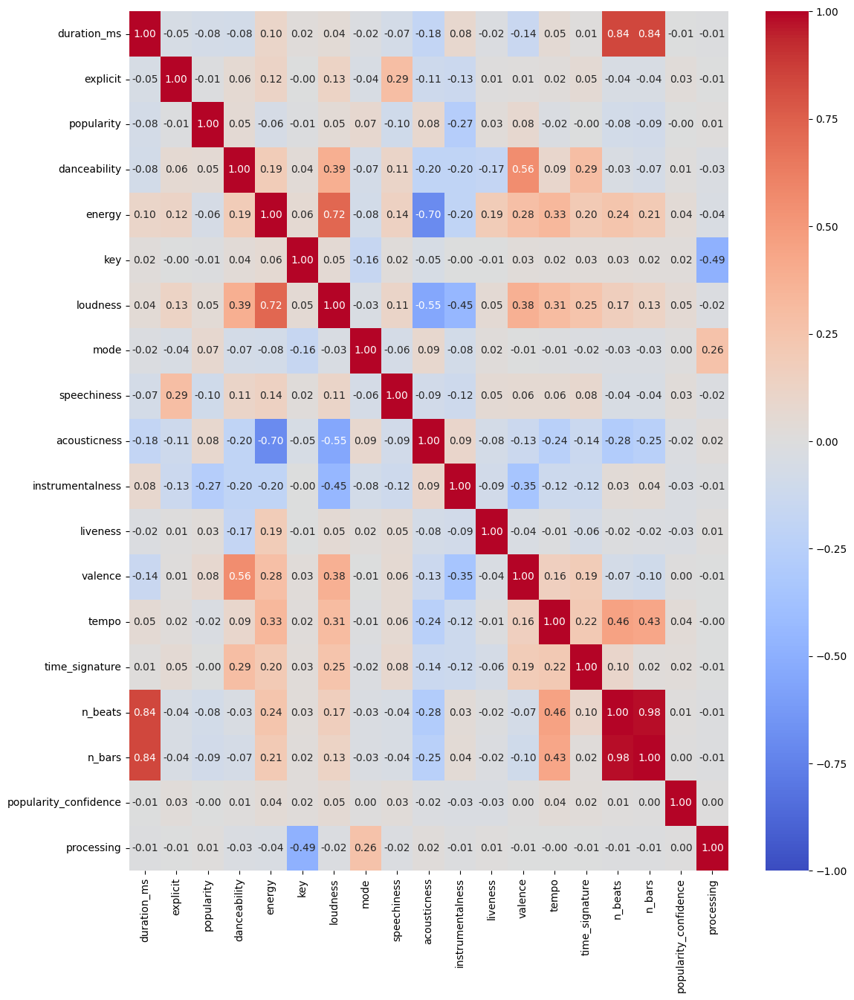

In [25]:
plt.figure(figsize=(13,15))
plt.title('Correlation with Pearson method - linear correlation coefficients')
sns.heatmap(df.corr(numeric_only=True,method='pearson'), cmap="coolwarm", vmin=-1,fmt='.2f', vmax=1, annot=True)

<Axes: title={'center': 'Correlation with Spearman method - monotonic correlation coefficients'}>

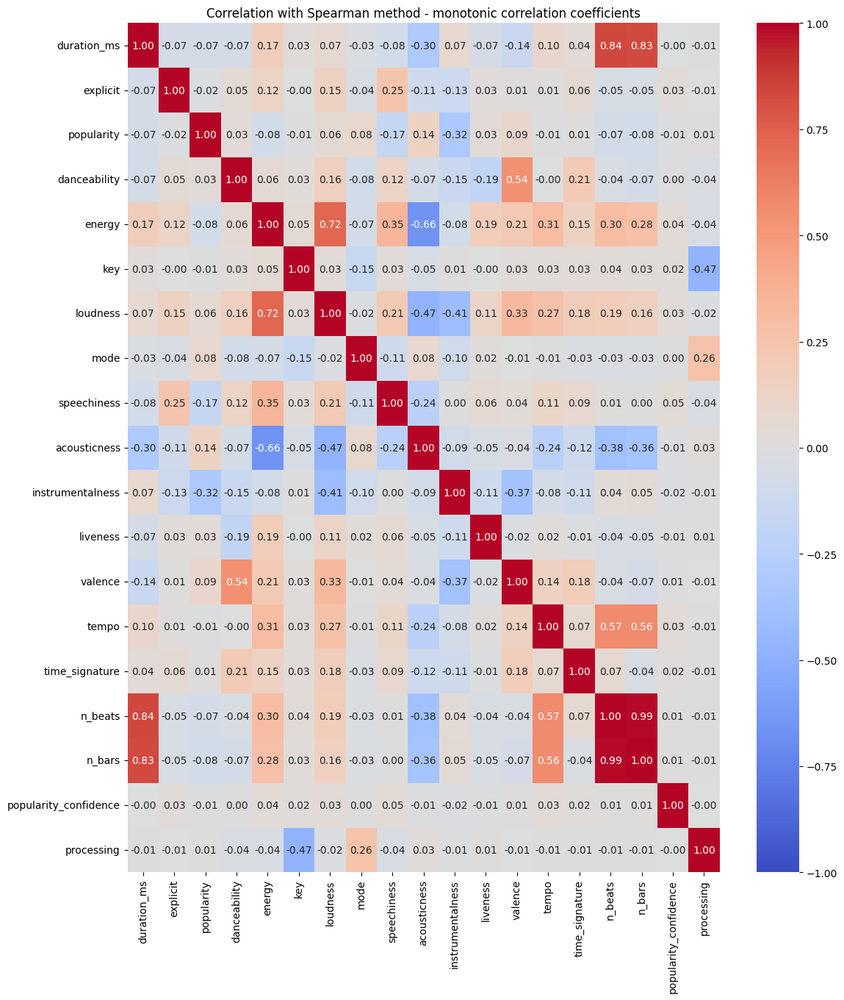

In [26]:
plt.figure(figsize=(13,15))
plt.title('Correlation with Spearman method - monotonic correlation coefficients')
sns.heatmap(df.corr(numeric_only=True,method='spearman'), cmap="coolwarm", vmin=-1,fmt='.2f', vmax=1, annot=True)

In [31]:
pearson_vs_spearman=np.array(df.corr(numeric_only=True) - df.corr(numeric_only=True,method='spearman'))
print(np.max(pearson_vs_spearman))

0.22610881543244338


In [32]:
df.corr(numeric_only=True) - df.corr(numeric_only=True,method='spearman')

,duration_ms,explicit,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,n_beats,n_bars,popularity_confidence,processing
duration_ms,0.000000,2.078305e-02,-0.001481,-0.009684,-0.069892,-0.008875,-0.030504,1.928982e-03,0.006213,0.115716,0.007773,0.045284,-0.000349,-0.051790,-0.029789,-0.000962,0.005168,-0.004161,-0.001082
explicit,0.020783,0.000000e+00,0.005279,0.002960,0.002838,-0.000903,-0.015869,5.551115e-17,0.041513,-0.005263,0.005714,-0.019049,-0.003647,0.008705,-0.010644,0.008302,0.010312,-0.000110,0.001475
popularity,-0.001481,5.278596e-03,0.000000,0.018539,0.027506,-0.000557,-0.012761,-7.497658e-03,0.068916,-0.058387,0.048502,-0.006090,-0.011394,-0.015085,-0.015199,-0.010456,-0.009095,0.004279,-0.002293
danceability,-0.009684,2.960308e-03,0.018539,0.000000,0.136392,0.004082,0.226109,1.252320e-02,-0.013065,-0.124958,-0.055525,0.016688,0.019073,0.093381,0.083335,0.009262,0.001633,0.008894,0.010729
energy,-0.069892,2.837636e-03,0.027506,0.136392,0.000000,0.004072,-0.000346,-9.632306e-03,-0.201602,-0.038808,-0.123134,0.005644,0.070522,0.026253,0.057050,-0.056178,-0.068853,-0.001030,0.002684
key,-0.008875,-9.031665e-04,-0.000557,0.004082,0.004072,0.000000,0.015751,-3.130808e-03,-0.015385,0.001488,-0.011974,-0.004757,0.000008,-0.002771,-0.005898,-0.008801,-0.009180,0.001848,-0.018299
loudness,-0.030504,-1.586888e-02,-0.012761,0.226109,-0.000346,0.015751,0.000000,-1.217189e-02,-0.101149,-0.079877,-0.040192,-0.063589,0.050728,0.034797,0.071851,-0.020867,-0.031583,0.017108,-0.001755
mode,0.001929,5.551115e-17,-0.007498,0.012523,-0.009632,-0.003131,-0.012172,0.000000e+00,0.042559,0.006751,0.019934,-0.005824,-0.001756,-0.002455,0.006618,-0.000303,0.000179,-0.001090,-0.002665
speechiness,0.006213,4.151321e-02,0.068916,-0.013065,-0.201602,-0.015385,-0.101149,4.255872e-02,0.000000,0.152008,-0.118725,-0.006371,0.012312,-0.046018,-0.004910,-0.051939,-0.045737,-0.019722,0.020139
acousticness,0.115716,-5.263006e-03,-0.058387,-0.124958,-0.038808,0.001488,-0.079877,6.750943e-03,0.152008,0.000000,0.181565,-0.023557,-0.096940,-0.005516,-0.017809,0.093837,0.108574,-0.006557,-0.005680


There are some correlations that assume pretty different values using Spearman's method. 
Remembreing that Spearman's correlation coefficient seeks for monotonic correlation of all types, means that some attributes have a nonlinear correlation. 
For now, setting an arbitrary threshold for the difference to be considerable if >10%.

In [58]:
mask= pearson_vs_spearman>0.1
#print(mask)
#print(np.where(mask))
indexes=np.column_stack((np.where(mask)[0], np.where(mask)[1]))
#print(indexes[0])
print(np.column_stack((np.where(mask)[0], np.where(mask)[1])))

[[ 0  9]
 [ 3  4]
 [ 3  6]
 [ 4  3]
 [ 6  3]
 [ 8  9]
 [ 9  0]
 [ 9  8]
 [ 9 10]
 [ 9 16]
 [10  9]
 [13 14]
 [14 13]
 [16  9]]


### What has to be done for making everything less messy? 
- Finding strongly correlated quantities for eliminating redundant ones. Strongly correlated quantities bring the same information. 

### The `popularity_confidence` issue
It has been noted that the `popularity_confidence` attribute has less than $\frac{1}{8}$ of not-`NaN` values. 
Before decinding to delete the function, it is of interest of understanding for which `popularity` values the `popularity_confidence` is not `NaN`. 

The number of data objects having non null popularity confidence is: 2217
The pearson correlation between the two parameters is: -0.003665
The spearman correlation between the two parameters is: -0.007944


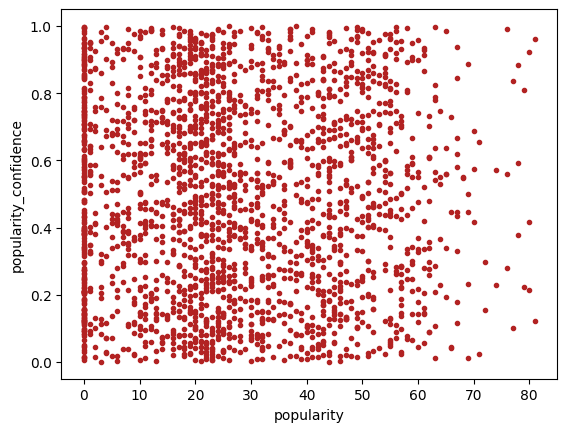

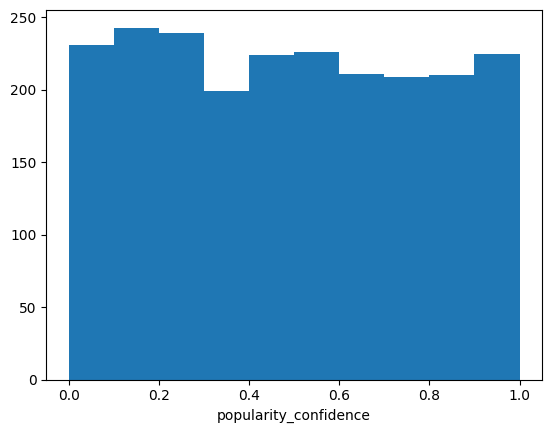

In [22]:
#plotting popularity_confidence vs popularity
df_tmpcopy=df[df['popularity_confidence'].notnull()]
print(f'The number of data objects having non null popularity confidence is: {len(df_tmpcopy)}')
print(f'The pearson correlation between the two parameters is: -0.003665')
print(f'The spearman correlation between the two parameters is: -0.007944')
plt.figure(1)
plt.errorbar(df_tmpcopy['popularity'],df_tmpcopy['popularity_confidence'], marker='.',linestyle='',color='firebrick')
plt.xlabel('popularity')
plt.ylabel('popularity_confidence')
plt.figure(2)
plt.hist(df_tmpcopy['popularity_confidence'],bins=10)
plt.xlabel('popularity_confidence')
plt.show()

Not expected behaviour, not-`NaN` values of `popularity_confidence` spans all space, even if they are not equally distributed. The not-`NaN` values are more dense in the region of low `popularity`, and more sparse in the region of higher popularity. There aren't 'white spaces' anyway. 
Anyway, the correlation is negative (as expected from plot) but really low, both Peason and Spearman. 
### What to do? Think about it.
The other issue is when the value of `popularity_confidence` is zero, in that case, does `popularity` value makes sense?

### Dealing with NaN values
Before deciding if keeping attributes or not, let's 'replace' the `NaN` values in some way. 
For mantaining the pdf/pmf of attributes, maybe the best idea is sampling from the distribution of the not-`NaN` values. 
- For discrete categories, we simply consider frequencies of each category and sampling;
- For continuous categories, interpoling not-`NaN` datapoints in order to obtain the pdf.

### Searching for division between podcasts and songs
- ADDING NUMERIC MAP FOR GENRE!!!
- Try to see the correlation plot inserting `genre` as `hue`.

In [11]:
df['genre'].value_counts()
genre_map={"j-dance":0,"iranian":1,"brazil":2,"chicago-house":3,"forro":4,"idm":5,"indian":6,"study":7,"disney":8,"afrobeat":9,"mandopop":10,"techno":11,"sleep":12,"spanish":13,"j-idol":14,"industrial":15,"happy":16,"bluegrass":17,"black-metal":18,"breakbeat":19}
df.replace({'genre':genre_map}).corr(numeric_only=True).style.background_gradient(cmap='coolwarm',vmin=-1,vmax=1) #!!!

,duration_ms,explicit,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,features_duration_ms,time_signature,n_beats,n_bars,popularity_confidence,processing,genre
duration_ms,1.000000,-0.048723,-0.076202,-0.080932,0.102996,0.016712,0.039403,-0.023310,-0.074774,-0.184902,0.079685,-0.021184,-0.141938,0.048765,0.999918,0.009033,0.839313,0.838041,-0.005830,-0.010400,0.030701
explicit,-0.048723,1.000000,-0.013096,0.056992,0.124405,-0.000991,0.131777,-0.042846,0.294287,-0.113975,-0.125101,0.006995,0.008631,0.016972,-0.048699,0.051260,-0.039830,-0.039435,0.029119,-0.005878,-0.031463
popularity,-0.076202,-0.013096,1.000000,0.051046,-0.056547,-0.008992,0.046703,0.073043,-0.096382,0.078424,-0.266843,0.027105,0.077652,-0.024162,-0.076228,-0.003160,-0.084774,-0.089134,-0.003665,0.008733,0.035557
danceability,-0.080932,0.056992,0.051046,1.000000,0.193940,0.035311,0.385244,-0.072422,0.111454,-0.199082,-0.202316,-0.174193,0.559578,0.092267,-0.080891,0.292167,-0.033604,-0.069332,0.011602,-0.026273,-0.125284
energy,0.102996,0.124405,-0.056547,0.193940,1.000000,0.057815,0.720907,-0.079969,0.143454,-0.699454,-0.203111,0.191024,0.284069,0.331538,0.102985,0.204646,0.243586,0.208615,0.040022,-0.037847,0.236734
key,0.016712,-0.000991,-0.008992,0.035311,0.057815,1.000000,0.047718,-0.157515,0.018157,-0.049867,-0.001532,-0.007420,0.028221,0.022414,0.016786,0.028388,0.027133,0.022042,0.019790,-0.490366,0.018896
loudness,0.039403,0.131777,0.046703,0.385244,0.720907,0.047718,1.000000,-0.033544,0.109793,-0.552519,-0.447106,0.047502,0.377743,0.308203,0.039415,0.250568,0.165565,0.131064,0.049174,-0.020563,0.119055
mode,-0.023310,-0.042846,0.073043,-0.072422,-0.079969,-0.157515,-0.033544,1.000000,-0.064289,0.085246,-0.080035,0.015738,-0.006907,-0.013001,-0.023409,-0.019378,-0.030685,-0.027687,0.003698,0.261129,0.056051
speechiness,-0.074774,0.294287,-0.096382,0.111454,0.143454,0.018157,0.109793,-0.064289,1.000000,-0.087997,-0.115803,0.050034,0.056068,0.062161,-0.074722,0.080739,-0.043217,-0.040820,0.026399,-0.022909,-0.118012
acousticness,-0.184902,-0.113975,0.078424,-0.199082,-0.699454,-0.049867,-0.552519,0.085246,-0.087997,1.000000,0.094256,-0.075924,-0.131961,-0.244244,-0.184846,-0.139706,-0.283324,-0.248164,-0.021155,0.022684,-0.196470


<Axes: title={'center': 'Correlation with Spearman method - monotonic correlation coefficients'}>

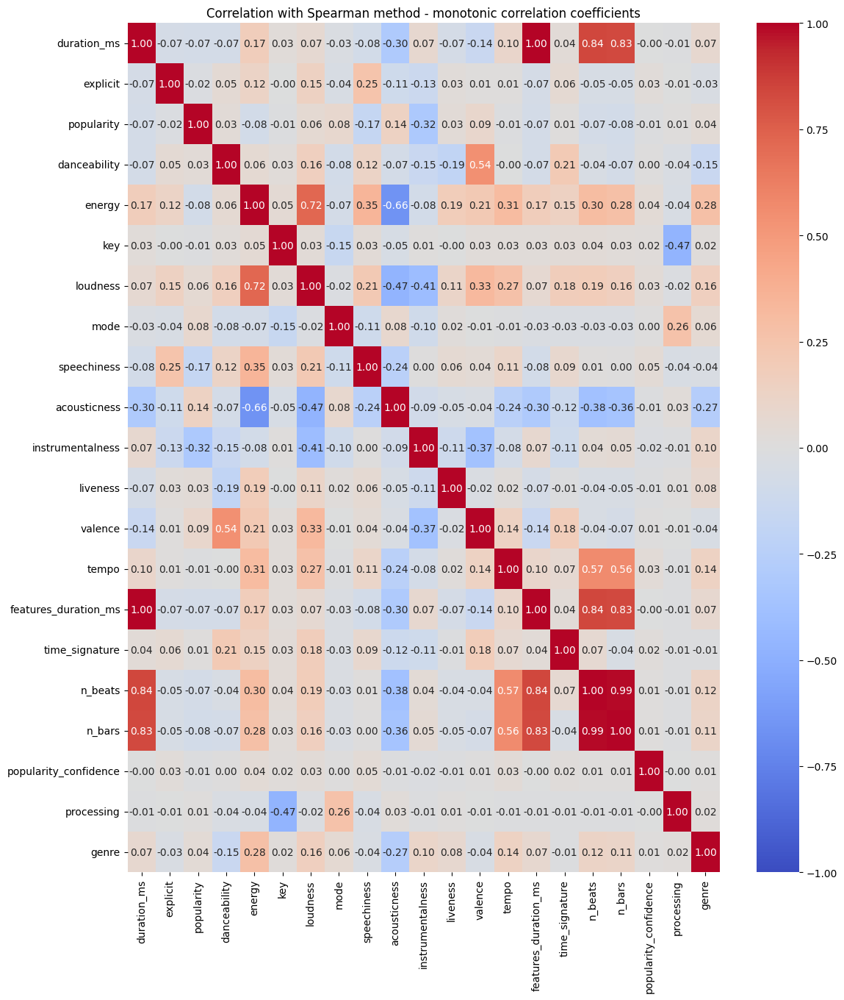

In [16]:
genre_map={"j-dance":0,"iranian":1,"brazil":2,"chicago-house":3,"forro":4,"idm":5,"indian":6,"study":7,"disney":8,"afrobeat":9,"mandopop":10,"techno":11,"sleep":12,"spanish":13,"j-idol":14,"industrial":15,"happy":16,"bluegrass":17,"black-metal":18,"breakbeat":19}
df.replace({"genre":genre_map})
plt.figure(figsize=(13,15))
plt.title('Correlation with Spearman method - monotonic correlation coefficients')
sns.heatmap(df.replace({"genre":genre_map}).corr(numeric_only=True,method='spearman'), cmap="coolwarm", vmin=-1,fmt='.2f', vmax=1, annot=True)

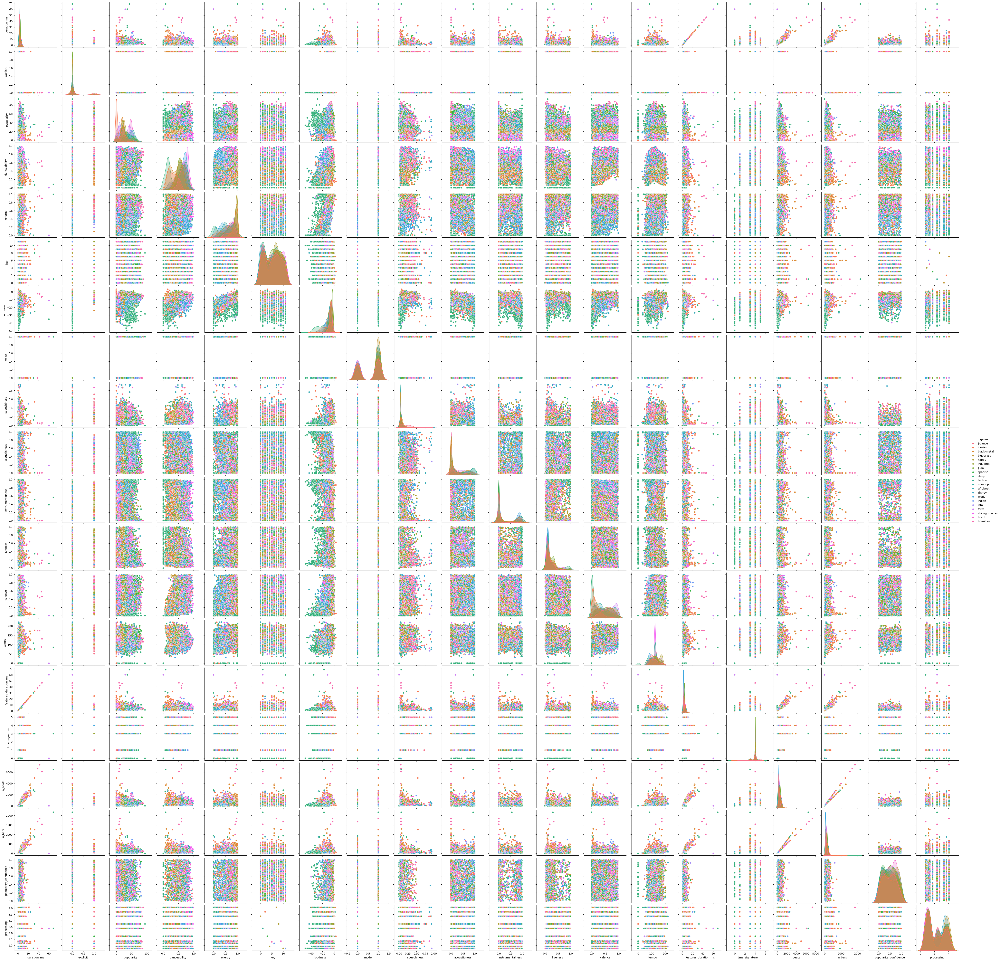

In [19]:
sns.pairplot(df,diag_kind='kde',hue='genre')
#kde is the distribution command for diagonal plot
plt.show()

In [3]:
df.isnull().sum()

name                         0
duration_ms                  0
explicit                     0
popularity                   0
artists                      0
album_name                   0
danceability                 0
energy                       0
key                          0
loudness                     0
mode                      4450
speechiness                  0
acousticness                 0
instrumentalness             0
liveness                     0
valence                      0
tempo                        0
features_duration_ms         0
time_signature            2062
n_beats                      0
n_bars                       0
popularity_confidence    12783
processing                   0
genre                        0
dtype: int64

- seeking outliers and understanding what to do with them
- filter genres and do scatter plots in groups

### Resolving missing values issue
Before deciding what to do with `probability_confidence` attribute, let's resolve the other two attributes issue. 
- `mode` has 4450 `NaN` values;
- `time_signature` has 2062 `NaN` values.

We have decided to use a method that conserves the pdf of the attribute. For doing so, we sample the value to be replaced to the missing value via a sampling from the pdf/pmf of the specific attribute. 
- `mode` is a binary value, because of that, it is sufficient to compute $p(mode=0)=p_0$, $p(mode=1)=p_1$;
- `time_signature`

p0=0.3686255924170616 , p1=0.6313744075829384


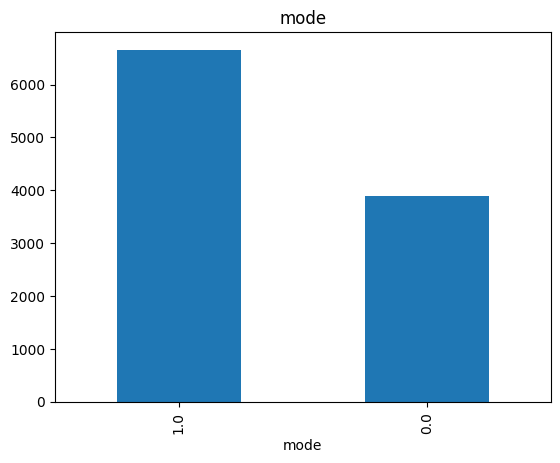

In [20]:
#Computing p0 and p1 and filling missing values of mode attribute by sampling
df['mode'].value_counts().plot(kind='bar', title='mode')
p0=df['mode'].value_counts()[0]/(len(df)-df['mode'].isnull().sum())
p1=df['mode'].value_counts()[1]/(len(df)-df['mode'].isnull().sum())
print(f'p0={p0} , p1={p1}')

In [26]:
list_of_nan_indexes=df[df['mode'].isnull()].index.tolist()
#print(list_of_nan_indexes)
print(len(list_of_nan_indexes))

4450


In [28]:
for i in list_of_nan_indexes:
    #df.loc[i,'mode']
    #df.loc[['viper', 'sidewinder'], ['shield']] = 50
    if np.random.random() < p1:
        df.loc[i,'mode'] = 1.0
    else:
        df.loc[i,'mode'] = 0.0

In [33]:
df['mode'].isnull().sum()

0

p0=0.3682666666666667 , p1=0.6317333333333334


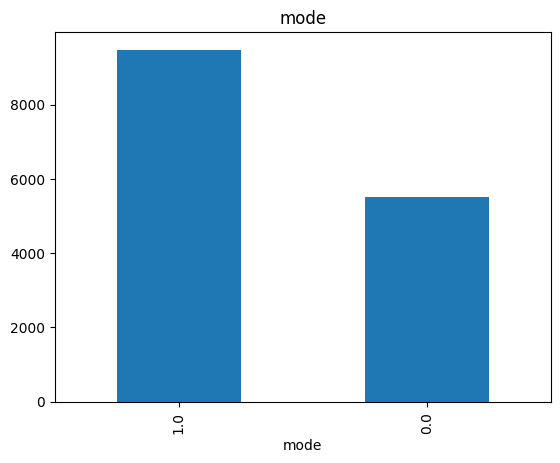

In [34]:
#Computing p0 and p1 again in order to assure that everything went good
df['mode'].value_counts().plot(kind='bar', title='mode')
p0=df['mode'].value_counts()[0]/(len(df)-df['mode'].isnull().sum())
p1=df['mode'].value_counts()[1]/(len(df)-df['mode'].isnull().sum())
print(f'p0={p0} , p1={p1}')


As expected, the method left the pmf barely invariate. 

In [35]:
df['time_signature'].value_counts()

time_signature
4.0    11160
3.0     1162
5.0      375
1.0      149
0.0       92
Name: count, dtype: int64

In [36]:
df['time_signature'].isnull().sum()

2062

<Axes: title={'center': 'time_signature attribute pmf'}, xlabel='time_signature'>

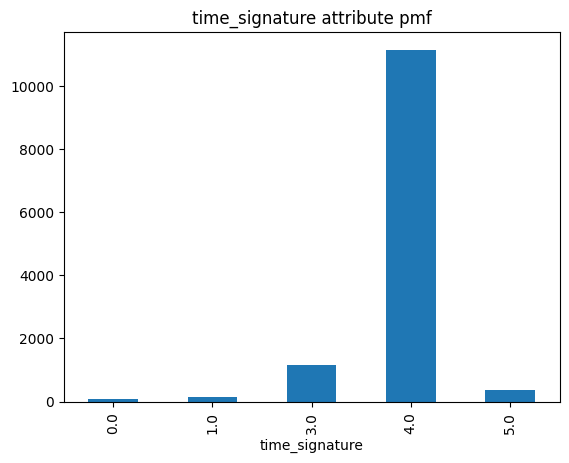

In [38]:
df['time_signature'].value_counts().sort_index(ascending=True).plot(kind='bar', title='time_signature attribute pmf')

Why there is no 2.0? 

In [ ]:
list_of_nan_indexes_ts=df[df['mode'].isnull()].index.tolist()
#print(list_of_nan_indexes)
print(len(list_of_nan_indexes_ts))
from scipy.stats import multinomial 
for i in list_of_nan_indexes:
    #df.loc[i,'mode']
    #df.loc[['viper', 'sidewinder'], ['shield']] = 50
    if np.random.random() < p1:
        df.loc[i,'mode'] = 1.0
    else:
        df.loc[i,'mode'] = 0.0

multinomial.rvs(n, p, size=1, random_state=None)